In [2]:
!pip install catboost plotly

[Данные](https://yadi.sk/d/CBoVCVIxJ2q2cw)

# Обработка лидарных данных
## Сегментация

### Про лидар

![](https://realnoevremya.com/uploads/gallery/b9/7e/35d10da899958110.jpg)

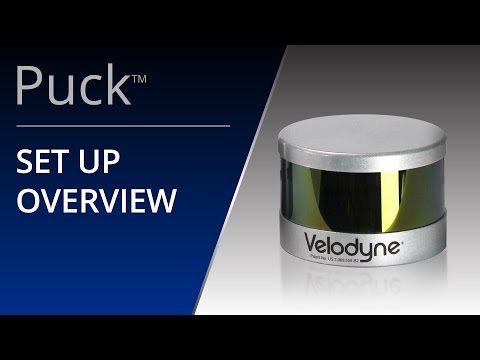

In [3]:
from IPython.lib.display import YouTubeVideo
YouTubeVideo('Pa-q5elS_nE')

## А что за данные на самом деле


In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

import plotly.offline as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
import tqdm
py.init_notebook_mode(connected=True)

EQUAL_ASPECT_RATIO_LAYOUT = dict(
    margin={
        'l': 0,
        'r': 0,
        'b': 0,
        't': 0
    }, scene=dict(
    aspectmode='data'
))


def color(x, cmap='Reds'):
    cmap = plt.get_cmap(cmap)
    x = (x - np.min(x)) / np.max(x)
    
    return cmap(x)

%matplotlib inline

In [2]:
ds = pd.read_csv('snow.csv')
ds = ds.set_index(['scene_id'])
ds.head()

,x,y,z,intensity,ring,label
scene_id,,,,,,
0,-11.355618,-4.206962,0.344085,0.0,23.0,1.0
0,-5.916535,-1.972164,0.283262,0.0,25.0,1.0
0,-7.410451,-2.113039,2.137792,0.0,31.0,1.0
0,-13.845870,-1.406652,0.406310,0.0,23.0,1.0
0,-8.326218,-0.346060,0.226469,0.0,22.0,1.0


* intensity - ???
* ring - ???

### Кольцо

![](https://eckop.com/wp-content/uploads/2018/07/LIDAR_02-1024x366.png)

In [3]:
scene = ds.loc[0]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.ring, 'tab20'),
    },
    'text': scene.ring
})

py.iplot(fig)


### Интенсивность

![](https://res.mdpi.com/sensors/sensors-15-28099/article_deploy/html/images/sensors-15-28099-g001-1024.png)

In [4]:
fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.intensity, 'seismic'),
    },
    'text': scene.intensity
})

py.iplot(fig)

In [5]:
scene = ds.loc[1]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.intensity, 'seismic'),
    },
    'text': scene.ring
})

py.iplot(fig)


# Отфильтруем снег

## Эвристикой

In [6]:
def filter_by_intensity(intensity, limit=7):
    return intensity > limit

filtered_scene = scene[filter_by_intensity(scene.intensity)]


fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': filtered_scene.x,
    'y': filtered_scene.y,
    'z': filtered_scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(filtered_scene.intensity, 'seismic'),
    },
    'text': scene.ring
})

py.iplot(fig)

Плохо и непонятно, будем учить

## Облачные вычисления

In [8]:
from sklearn.neighbors import KDTree

class ComputeFeatures(object):
    def __init__(self, r=1.0):
        self.xyz = None
        self.intensity = None
        self.ring = None
        self.index = None
        self.r = r

    def _feature_names(self):
        return self.feat_names
    
    def compute_point_features(self, point_id, neighbours):
        name_pack = ['max', 'mean', 'min', 'std', 'var', 'ptp']
        feat_pack = [
            lambda x: x.max(),
            lambda x: x.mean(),
            lambda x: x.min(),
            lambda x: x.std(),
            lambda x: x.var(),
            lambda x: x.ptp()
        ]
        F = lambda y, x: ([f'{y}_{name}' for name in name_pack], [feat(x) for feat in feat_pack])
        packs = [
            F('intensity', self.intensity[neighbours]),
            F('ring', self.ring[neighbours]),
            F('x', self.xyz[neighbours][:, 0]),
            F('y', self.xyz[neighbours][:, 1]),
            F('z', self.xyz[neighbours][:, 2]),
            F('xyz', self.xyz[neighbours]),
            (['nbr_count'], [len(neighbours)])
        ]
        feat_vals = []
        self.feat_names = []
        
        for pack in packs:
            nms, vls = pack
            self.feat_names.extend(nms)
            feat_vals.extend(vls)
        
        return feat_vals
    

    def get_point_neighbours(self, point_id):
        return self.index.query_radius(self.xyz[point_id][np.newaxis, :], r=self.r)[0]
        
    def __call__(self, xyz, intensity, ring):
        self.xyz = xyz[:]
        self.intensity = intensity[:]
        self.ring = ring[:]
        
        self.index = KDTree(self.xyz)
        
        features = []
        for point_id in range(len(self.xyz)):
            neighbours = self.get_point_neighbours(point_id)
            features.append(self.compute_point_features(point_id, neighbours))
        
        
        return pd.DataFrame(columns=self._feature_names(), data=features)

In [11]:
features = ComputeFeatures(r=1.0)

for scene_id in tqdm.tqdm(ds.reset_index().scene_id.unique()):
    scene = ds.loc[scene_id]
    features_df = \
        features(scene[['x', 'y', 'z']].values, scene.intensity.values, scene.ring.values)
    features_df.to_csv('features/{}.csv'.format(scene_id))

# Посмотрим на разметку

In [9]:
scene = ds.loc[1]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.label, 'seismic'),
    },
    'text': scene.label
})

py.iplot(fig)

## Поучим что-нибудь

In [10]:
data = []
for scene_idx in tqdm.tqdm(ds.index.unique(), position = 0, leave = False):
    path = f'features/{scene_idx}.csv'
    feats = pd.read_csv(path, index_col=None)
    feats.drop('Unnamed: 0', axis = 1, inplace = True)
    data.append(ds.loc[scene_idx].reset_index().merge(feats, left_index = True, right_index = True))
data = pd.concat(data, sort = False)
data.reset_index(drop = True, inplace = True)

In [11]:
train, val, test = np.split(data.sample(frac=1), [int(.6*len(data)), int(.8*len(data))])

In [12]:
import catboost

def learn(X_train, X_val, y_train, y_val):
    clf = catboost.CatBoostClassifier(n_estimators=100)
    clf.fit(
        X_train, y_train, early_stopping_rounds=10,
        use_best_model=True, eval_set=(X_val.values, y_val.values), plot=True, verbose=False)
    return clf

X_train = train.drop(["scene_id", "label", "x", "y", "z"], axis=1)
y_train = train.label


X_val = val.drop(["scene_id", "label", "x", "y", "z"], axis=1)
y_val = val.label

In [13]:
del ds
cls = learn(X_train, X_val, y_train, y_val)


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [14]:
X_test = test.drop(['scene_id', 'x', 'y', 'z', 'label'], axis=1)
y_test = test.label

from sklearn.metrics import precision_recall_curve, precision_score, recall_score

def test_one(clf, X_test, y_test):
    y_test_hat = clf.predict_proba(X_test)
    pr, rec, thr = precision_recall_curve(y_test, y_test_hat[:, 1])
    ix = np.linspace(1, len(pr)-1, num=2000).astype(int)
    return pr[ix], rec[ix], thr[ix - 1]


def heuristic_filter_scoring():
    pr = []
    rec = []
    filter_range = range(1, 10)
    for i in filter_range:
        y_test_heuristic_hat = np.ones(len(X_test))
        y_test_heuristic_hat[filter_by_intensity(test.intensity, i)] = 0
        pr.append(precision_score(y_test, y_test_heuristic_hat))
        rec.append(recall_score(y_test, y_test_heuristic_hat))
        
    return pr, rec, filter_range

pr_bl, rec_bl, thr_bl = heuristic_filter_scoring()

def plot_pr_rec(*models):
    traces = []
    for model, clf, X_test, y_test in models:
        pr, rec, thr = test_one(clf, X_test, y_test)
        pr_rec = go.Scattergl(x = rec, y = pr, mode='lines', text=thr, name=model)
        traces.append(pr_rec)

    pr_rec_bl = go.Scatter(x = rec_bl, y = pr_bl, mode='lines+markers', text=list(map(str, thr_bl)), name='Intensity BL')

    layout = go.Layout(
        title='Precission-recall',
        xaxis=dict(
            title='Recall'
        ),
        yaxis=dict(
            title='Precission'
        ))
    fig = go.Figure(
        data=traces + [pr_rec_bl],
        layout=layout)
    py.iplot(fig)
    
models = [('Catboost classifier', cls, X_test, y_test)]
plot_pr_rec(*models)

In [19]:
cls.get_feature_importance(prettified = True).iloc[:10]

,Feature Id,Importances
0,nbr_count,17.727675
1,z_max,10.669413
2,z_mean,9.726416
3,intensity,7.637583
4,z_var,4.802516
5,intensity_mean,3.996100
6,intensity_min,3.841945
7,ring_std,3.089363
8,y_min,3.033820
9,intensity_max,2.963792


# Повизуализируем

In [20]:
y_test_hat = cls.predict_proba(test.drop(['scene_id', 'x', 'y', 'z', 'label'], axis=1))

In [21]:
itest = test.set_index(['scene_id'])

In [22]:
scene_id = 212
scene = itest.loc[scene_id]
scene_predictions = y_test_hat[test.scene_id == scene_id][:, 1]



In [44]:

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)


fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 2.5,
        'color': color(np.abs(scene_predictions - scene.label), 'seismic'),
    },
    'text': [f'mae : {np.round(i, 5)}' for i in np.abs(scene_predictions - scene.label)]
})


py.iplot(fig)